Tutorial on Scan-to-BIM using Python and Open3D
---

*This tutorial was presented at the 9th International Conference on Construction Engineering and Project Management (ICCEPM 2022)*

In this tutorial, we will be using open-source software tools to create Building Information Models (BIM) from 3D point clouds. We will use simple functions in Python and Open3D to reconstruct building walls and floors from sensor data. This notebook will provide step-by-step instructions on how to implement common point clouds processing algorithms such as filtering, normal estimation, clustering, and robust parameter estimation.

**NumPy Library**

NumPy is an open-source Python library for numerical computing. Documentation for NumPy can be found [here](https://numpy.org/doc/stable/user/basics.html).

**Open3D Library**

Open3D is an open-source library that supports rapid development of software that deals with 3D data. Documentation for using Open3D can be found [here](http://www.open3d.org/docs/release/getting_started.html).

**CloudCompare viewer**

[CloudCompare](https://www.danielgm.net/cc/) is an open-source 3D point cloud processing and visualization software. CloudCompare supports many open point cloud formats (ASCII, LAS, E57, etc.) as well as triangular meshes (OBJ, PLY, STL, FBX, etc.). The intermediate outputs from this notebook can be viewed and processed in CloudCompare.

# 1. Point Cloud Data Loading and Visualization

In the first step, we will load a 3D point cloud from a .PLY file and visualize it using Open3D.

In [ ]:
# Install the Open3D library
# This step is needed because Open3D is not a standard library included in Google Colab
!pip install open3d

In [ ]:
# Install the IFCOpenShell library so that we can create a Building Information Models using the IFC format
!pip install python-ifcopenshell

In [1]:
# Mount a Google Drive folder so that the data files can be accessed
from google.colab import drive
from google.colab import files
import sys
drive.mount('/content/drive', force_remount=True)
%cd drive/MyDrive/ICCEPM_2022_Scan2BIM
sys.path.insert(0,'/content/drive/MyDrive/ICCEPM_2022_Scan2BIM/')

Mounted at /content/drive
/content/drive/MyDrive/ICCEPM_2022_Scan2BIM


In [2]:
# Import libraries and utility functions
import open3d as o3d
import numpy as np
import scipy.ndimage as ndimage
import matplotlib.pyplot as plt
from utils import draw_geometries
from utils import writeIFC

In [3]:
# Load a sample point cloud using the Open3D library
pcd_object = o3d.io.read_point_cloud("sample1.ply")
# Convert to a NumPy array for further processing
initial_pcd = np.hstack([pcd_object.points, pcd_object.colors]).astype(np.float32)
print("Point cloud dimensions are: ", initial_pcd.shape)
np.set_printoptions(precision=3, suppress=True)
print("Point cloud coordinates are:")
print(initial_pcd)

Point cloud dimensions are:  (76738, 6)
Point cloud coordinates are:
[[ 880.833 1149.219   97.833    0.514    0.533    0.557]
 [ 659.67   635.933  182.366    0.576    0.58     0.663]
 [ 659.567  635.883  182.494    0.055    0.067    0.141]
 ...
 [ 694.928  671.614  197.374    1.       1.       1.   ]
 [ 695.005  671.668  197.471    1.       1.       1.   ]
 [ 895.117  747.138  203.476    0.996    1.       1.   ]]


In [4]:
# Visualize the point cloud using a 3D web viewer
pcd_object.points = o3d.utility.Vector3dVector(initial_pcd[:, 0:3])
pcd_object.colors = o3d.utility.Vector3dVector(initial_pcd[:, 3:6])
draw_geometries([pcd_object], show_axes=True)

# 2. Pre-processing and filtering

Next, we will perform the following pre-processing steps to facilitate further operations on the point cloud:

*   Rotate the point cloud to align the walls with the X-Y axes
*   Filter the point cloud to remove points outside of the region of interest



In [5]:
# function to find the angle that maximizes the sum of the top values on the x, y-axis histogram
# returns an angle in the range [-45, 45]
def pcd_rotation(pcd, bins_size = 0.1):
    def find_best_angle(xy, min_angle, max_angle, bins = 9):
        gap = (max_angle - min_angle) / bins
        best_index, best_value = 0, 0
        for i in range(bins):
            if i == 0:
                best_value = sum_hist_maximums(xy, (min_angle+gap/2) + i*gap)
                continue
            cur = sum_hist_maximums(xy, (min_angle+gap/2) + i*gap)
            if cur > best_value:
                best_value, best_index = cur, i
        new_min_angle, new_max_angle = min_angle + best_index*gap, min_angle + (best_index+1)*gap
        return new_min_angle, new_max_angle
            
    def sum_hist_maximums(xy, angle):
        R = create_rotation_matrix(angle)
        xy_rotated = np.matmul(R, xy.transpose())
        xy_rotated = xy_rotated.transpose()

        xy_range = np.max(xy_rotated, axis=0) - np.min(xy_rotated, axis=0)
        [bins_num_x, bins_num_y] = xy_range / bins_size
        [n_x, _] = np.histogram(xy_rotated[:,0], bins=int(bins_num_x))
        [n_y, _] = np.histogram(xy_rotated[:,1], bins=int(bins_num_y))

        # non-maximal suppression
        margin_eps = 0.3
        padding = np.ceil(margin_eps / bins_size)
        n_x_maxpooled = ndimage.maximum_filter1d(n_x, int(padding*2+1)) 
        n_y_maxpooled = ndimage.maximum_filter1d(n_y, int(padding*2+1)) 

        n_x_sorted = -np.sort(-n_x[n_x == n_x_maxpooled])
        n_y_sorted = -np.sort(-n_y[n_y == n_y_maxpooled])
        return np.sum(n_x_sorted[:20]) + np.sum(n_y_sorted[:20])

    def create_rotation_matrix(angle):
        theta = np.radians(angle)
        c, s = np.cos(theta), np.sin(theta)
        R = np.array(((c, -s), (s, c)))
        return R
        
    epsilon = 0.001
    min_angle, max_angle = -45, 45
    xy = pcd[:, 0:2]

    while (max_angle - min_angle) > epsilon:
        min_angle, max_angle = find_best_angle(xy, min_angle, max_angle)

    best_angle = (max_angle + min_angle) / 2
    R = create_rotation_matrix(best_angle)
    xy_rotated = np.matmul(R, xy.transpose())
    xy_rotated = xy_rotated.transpose()

    pcd_rotated = pcd
    pcd_rotated[:, 0:2] = xy_rotated

    return best_angle, pcd_rotated


In [6]:
best_angle, pcd_rotated = pcd_rotation(initial_pcd)
print('Point cloud is rotated by',best_angle,'degrees')

Point cloud is rotated by -26.529492455418378 degrees


Filtered point cloud from 76738 points to 49002 points


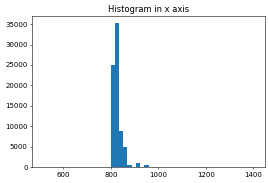

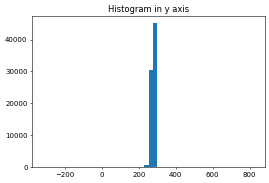

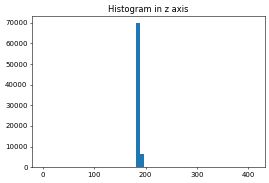

In [7]:
# function to remove unconnected_clusers based on histograms
def pcd_remove_unconnected_clusters(pcd, bins_size = 0.1):
    def find_boundary(samples, direction):
        samples_range = np.max(samples) - np.min(samples)
        plt.rcParams['figure.dpi'] = 50
        plt.figure()
        plt.hist(samples, bins=50)
        plt.title('Histogram in %s axis' % direction)
        n, bins = np.histogram(samples, bins=int(samples_range/bins_size))

        # non-maximal suppression
        margin_eps = 0.3
        padding = np.ceil(margin_eps / bins_size)
        n_maxpooled = ndimage.maximum_filter1d(n, int(padding*2+1))
        n_maxpooled[n_maxpooled < 100] = 0 
        
        left_bndry_ind, right_bndry_ind = 0, len(n_maxpooled)
        while np.sum(n_maxpooled[left_bndry_ind: right_bndry_ind] == 0) > padding:
            n_index = np.argwhere(n_maxpooled[left_bndry_ind:right_bndry_ind] == 0)
            ind = int(n_index[int(len(n_index)/2)]) + left_bndry_ind
            if np.sum(n[left_bndry_ind:ind]) < np.sum(n[ind:right_bndry_ind]):
                left_bndry_ind = ind
            else:
                right_bndry_ind = ind
                        
        return bins[left_bndry_ind], bins[right_bndry_ind]

    x, y, z = pcd[:,0], pcd[:,1], pcd[:,2]
    x_left_bndry, x_right_bndry = find_boundary(x, 'x')
    y_left_bndry, y_right_bndry = find_boundary(y, 'y')
    z_left_bndry, z_right_bndry = find_boundary(z, 'z')

    pcd_preprocessed = pcd
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,0] > x_left_bndry]
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,0] < x_right_bndry]
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,1] > y_left_bndry]
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,1] < y_right_bndry]
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,2] > z_left_bndry]
    pcd_preprocessed = pcd_preprocessed[pcd_preprocessed[:,2] < z_right_bndry]

    return pcd_preprocessed

pcd_filtered = pcd_remove_unconnected_clusters(pcd_rotated)
print("Filtered point cloud from", len(pcd_rotated),'points to',len(pcd_filtered),'points')

In [8]:
# Visualize point cloud after pre-processing
pcd_object.points = o3d.utility.Vector3dVector(pcd_filtered[:, 0:3])
pcd_object.colors = o3d.utility.Vector3dVector(pcd_filtered[:, 3:6])
draw_geometries([pcd_object], show_axes=True)

In [ ]:
# The point cloud can also be exported and subsequently processed with other software
o3d.io.write_point_cloud('output.ply', pcd_object)

True

# 3. Ceiling and Floor Extraction

Next, we will estimate the floor and ceiling level. The ceiling and floor points are then filtered out.



Floor level is 0.05m, Ceiling level is 4.05m
Extracted 1736 points from ceiling, 3686 points from floor


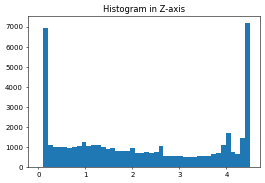

In [9]:
# function to estimate the floor level and ceiling level based on the Z-axis histogram
def find_ceiling_floor(pcd, z_histogram_resolution = 0.1, z_histogram_threshold = 1000, max_storey_height = 4):

    plt.figure()
    plt.hist(pcd[:, 2], bins=int((pcd[:, 2].max() - pcd[:, 2].min()) / z_histogram_resolution))
    plt.title('Histogram in Z-axis')

    discrete_z = np.round(pcd[:, 2] / z_histogram_resolution).astype(int)
    u, c = np.unique(discrete_z, return_counts=True)
    u = u[c > z_histogram_threshold]
    floor_level = (u[0] - 0.5) * z_histogram_resolution
    ceiling_level = (u[-1] + 0.5) * z_histogram_resolution
    if ceiling_level - floor_level > max_storey_height:
        ceiling_level = floor_level + max_storey_height
    pcd_mid = pcd[(pcd[:, 2] > floor_level) & (pcd[:, 2] < ceiling_level), :]
    print('Floor level is %.2fm, Ceiling level is %.2fm' % (floor_level, ceiling_level))

    ceiling_points = pcd_mid[pcd_mid[:, 2] >= ceiling_level - z_histogram_resolution]
    floor_points = pcd_mid[pcd_mid[:, 2] <= floor_level + z_histogram_resolution]
    print('Extracted %d points from ceiling, %d points from floor' % (len(ceiling_points), len(floor_points)))
    return ceiling_points, floor_points, pcd_mid, ceiling_level, floor_level

base_offset = pcd_filtered.min(axis=0)
pcd_filtered -= base_offset
ceiling_points, floor_points, remaining_points, ceiling_level, floor_level = find_ceiling_floor(pcd_filtered)

In [10]:
# Visualize floor points, ceiling points, as well as the remaining points
pcd1 = o3d.geometry.PointCloud()
pcd1.points = o3d.utility.Vector3dVector(remaining_points[:,:3])
pcd1.colors = o3d.utility.Vector3dVector([[1,0,0]]*len(remaining_points))
pcd2 = o3d.geometry.PointCloud()
pcd2.points = o3d.utility.Vector3dVector(floor_points[:,:3])
pcd2.colors = o3d.utility.Vector3dVector([[0,0,1]]*len(floor_points))
pcd3 = o3d.geometry.PointCloud()
pcd3.points = o3d.utility.Vector3dVector(ceiling_points[:,:3])
pcd3.colors = o3d.utility.Vector3dVector([[0,1,0]]*len(ceiling_points))
draw_geometries([pcd1, pcd2, pcd3], ['remaining', 'floor', 'ceiling'])

# 4. Point Cloud Clustering

Next, we will compute the normal vector for each point and use that information to group points into clusters corresponding to individual objects. The normal vector is a unit vector which is perpendicular to the local surface at a given point. Clustering can then be performed by grouping points that have normals pointing in similar directions.

In [11]:
# compute normal vector at each point
pcd_object.points = o3d.utility.Vector3dVector(remaining_points[:, :3])
pcd_object.estimate_normals(search_param=o3d.geometry.KDTreeSearchParamHybrid(radius=0.4, max_nn=50))
normals = np.asarray(pcd_object.normals)
remaining_points = np.hstack((remaining_points, normals)).astype(np.float32)

# visualize the directions of the normal vectors
pcd_object.colors = o3d.utility.Vector3dVector(np.abs(normals))
draw_geometries([pcd_object])

In [12]:
# filter out points that have vertical normals, since walls should have normals close to the horizontal direction
normals = remaining_points[:, 6:9]
filter_idx = np.abs(normals[:, 2]) < 0.3
wall_points = remaining_points[filter_idx]

In [13]:
# The Manhattan world assumption is applied, where we assume that wall points have normals that are oriented 
# either along the X-axis (1st Manhattan direction) or the Y-axis (2nd Manhattan direction).
normals = wall_points[:, 6:9]
normal_horizontal = normals[:, :2] / np.linalg.norm(normals[:, :2], axis=1).reshape(-1,1)
mlabels = np.zeros(len(normals), dtype=int)
mlabels[np.abs(normal_horizontal[:, 0]) > 0.95] = 1
mlabels[np.abs(normal_horizontal[:, 1]) > 0.95] = 2
print("%d points in 1st Manhattan direction" % (mlabels==1).sum())
print("%d points in 2nd Manhattan direction" % (mlabels==2).sum())
print("%d points in non-Manhattan direction" % (mlabels==0).sum())

6084 points in 1st Manhattan direction
10860 points in 2nd Manhattan direction
4188 points in non-Manhattan direction


In [14]:
# perform clustering and assign an integer cluster label to each point
cluster_object = o3d.geometry.PointCloud()
cluster_object.points = o3d.utility.Vector3dVector(wall_points[mlabels==1, :3])
xlabels = np.array(cluster_object.cluster_dbscan(eps=0.3, min_points=0, print_progress=False))
cluster_object.points = o3d.utility.Vector3dVector(wall_points[mlabels==2, :3])
ylabels = np.array(cluster_object.cluster_dbscan(eps=0.3, min_points=0, print_progress=False))

xlabels[xlabels >= 0] += 1
xlabels[xlabels < 0] = 0
num_clusters = xlabels.max() + 1
ylabels[ylabels >= 0] += num_clusters
ylabels[ylabels < 0] = 0
num_clusters = ylabels.max() + 1
cluster_label = np.array(list(xlabels) + list(ylabels))
clustered_wall_points = np.vstack((wall_points[mlabels==1], wall_points[mlabels==2]))
print('Found %d clusters from %d points'%(cluster_label.max(), len(clustered_wall_points)))

Found 180 clusters from 16944 points


In [15]:
# Visualize the clustering results, where a random unique color is assigned to each
# cluster of points
pcd_object.points = o3d.utility.Vector3dVector(clustered_wall_points[:, :3])
color_sample_state = np.random.RandomState(0)
obj_color = color_sample_state.random((np.max(cluster_label)+1,3))
pcd_object.colors = o3d.utility.Vector3dVector(obj_color[cluster_label])
draw_geometries([pcd_object])

# 5. Wall Parameter Estimation

Next, we will extract the wall instances from the point cloud. For each point cloud cluster, the Random Sample Consensus (RANSAC) algorithm is used to estimate the wall parameters robustly given the presence of outlier point. Each wall is parameterized as an extruded 2D line segment following the equation *ax + by + c = 0*, where *[a,b,c]* are the parameters to be estimated. Several simple filtering criteria such as minimum number of points, minimum length, and minimum height are applied to discard false detections.

In [16]:
# function that implements the Random Sample Consensus algorithm to find the best-fitting line
def fitLineRANSAC(points, ransac_inlier_thresh = 0.02, ransac_iters = 100):
    best_params = None
    max_inliers = 0
    for i in range(ransac_iters):
        sample_idx = np.random.choice(len(points), 2, replace=False)
        N = [points[sample_idx[0], 1] - points[sample_idx[1], 1], points[sample_idx[1], 0] - points[sample_idx[0], 0]]
        s = np.linalg.norm(N)
        if s > 0:
            N /= np.linalg.norm(N)
            # force normal to be in Manhattan direction
            if np.abs(N[0]) > 0.95:
                N = [-1, 0]
            elif np.abs(N[1]) > 0.95:
                N = [0, 1]
            line_params = [N[0], N[1], -(N[0]*points[sample_idx[0],0] + N[1]*points[sample_idx[0],1])]
            distance_to_line = np.abs(line_params[0] * points[:, 0] + line_params[1] * points[:, 1] + line_params[2])
            num_inliers = np.sum(distance_to_line < ransac_inlier_thresh)
            if num_inliers > max_inliers:
                max_inliers = num_inliers
                best_params = line_params
            if num_inliers > 0.95 * len(points):
                break
    distance_to_line = np.abs(best_params[0] * points[:, 0] + best_params[1] * points[:, 1] + best_params[2])
    inliers = points[distance_to_line < ransac_inlier_thresh]
    outliers = points[distance_to_line >= ransac_inlier_thresh]
    inlier0 = inliers[0, :2]
    tangent_vector = np.array([best_params[1], -best_params[0], best_params[2]])
    dp = (inliers[:, :2] - inlier0).dot(tangent_vector[:2])
    leftmost_point = inlier0 + dp.min() * tangent_vector[:2]
    rightmost_point = inlier0 + dp.max() * tangent_vector[:2]
    return inliers, outliers, leftmost_point, rightmost_point, tangent_vector

In [17]:
def get_wall_parameters(points, cluster_label, min_cluster_size = 75, wall_height_threshold = 0.6, ransac_min_inlier = 0.3, min_line_length = 0.2):
    
    walls = []
    for i in range(1, cluster_label.max() + 1):
        cluster_points = points[cluster_label == i]
        if len(cluster_points) <= min_cluster_size:
            continue
        wall_height = cluster_points[:,2].max()
        if wall_height < ceiling_level - wall_height_threshold:
            continue
        inliers, outliers, leftmost_point, rightmost_point, tangent_vector = fitLineRANSAC(cluster_points)
        if 1.0 * len(inliers) / len(cluster_points) < ransac_min_inlier:
            continue
        line_length = np.sqrt((leftmost_point[0] - rightmost_point[0])**2 + (leftmost_point[1] - rightmost_point[1])**2)
        if line_length < min_line_length:
            continue
        print('Line %d: %d points len=%.2f height=%.2f tangent='%(len(walls), len(inliers), line_length, wall_height), tangent_vector)
        walls.append([inliers, leftmost_point, rightmost_point, tangent_vector])
    return walls

walls = get_wall_parameters(clustered_wall_points, cluster_label)

Line 0: 489 points len=2.06 height=4.05 tangent= [ 0.     1.    11.026]
Line 1: 207 points len=0.84 height=4.03 tangent= [ 0.     1.    11.052]
Line 2: 1977 points len=10.88 height=4.05 tangent= [0.    1.    0.404]
Line 3: 685 points len=3.88 height=4.05 tangent= [0.    1.    9.207]
Line 4: 1690 points len=10.43 height=4.05 tangent= [ 1.     0.    -0.514]
Line 5: 1723 points len=10.35 height=4.05 tangent= [ 1.    0.   -7.49]
Line 6: 1135 points len=8.37 height=4.05 tangent= [  1.     0.   -11.76]


(-1.128350830078125,
 12.411859130859375,
 -0.9215423583984377,
 15.170901489257812)

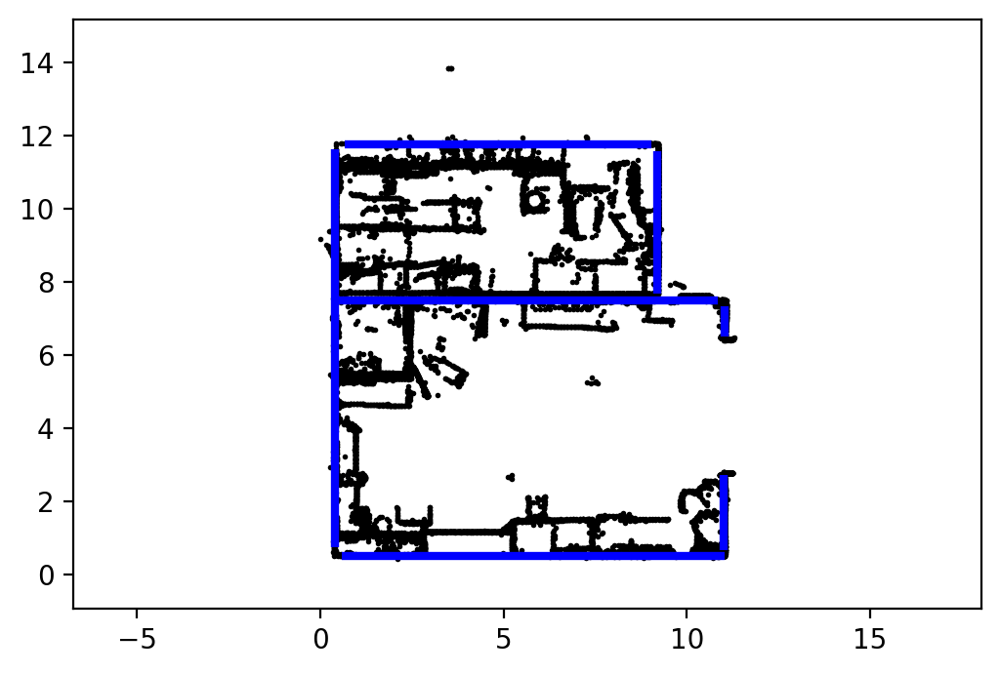

In [18]:
# Visualize the estimated line segments

lines = []
for inliers, leftmost_point, rightmost_point, tangent_vector in walls:
    lines.append([leftmost_point, rightmost_point])

from matplotlib import collections  as mc
plt.rcParams['figure.dpi'] = 200
lc = mc.LineCollection(lines, linewidths=3, color='blue')
fig, ax = plt.subplots()
plt.scatter(wall_points[:, 0], wall_points[:, 1], s=1, c='black')
ax.add_collection(lc)
#ax.autoscale()
ax.margins(0.1)
ax.axis('equal')

# 6. Creating an IFC Model

The final step is to create an output 3D model in the Industry Foundation Classes ([IFC](https://technical.buildingsmart.org/standards/ifc/)) format. IFC is a standardized, digital description of the built environment meant to be usable across a wide range of platforms. IFC files can be viewed using any of the following viewers:

*   [Autodesk viewer](https://viewer.autodesk.com/designviews)
*   [Solibri Anywhere](https://www.solibri.com/download-solibri-anywhere?step=1)



In [19]:

ifc_walls = []
for i in range(len(walls)):
    inliers, leftmost_point, rightmost_point, tangent_vector = walls[i]
    wall_height = inliers[:, 2].max() - floor_level
    thickness = 0.2 #default
    if np.abs(tangent_vector[0]) == 1:
        ifc_walls.append([leftmost_point[0], leftmost_point[1], rightmost_point[0]-leftmost_point[0], 'x', wall_height, thickness])
    elif np.abs(tangent_vector[1]) == 1:
        ifc_walls.append([leftmost_point[0], leftmost_point[1], rightmost_point[1]-leftmost_point[1], 'y', wall_height, thickness])

output_filename = "output.ifc"
writeIFC(ifc_walls, output_filename)
print("Saved to", output_filename, 'with', len(ifc_walls), 'wall entities')

Saved to output.ifc with 7 wall entities


Acknowledgements
---

The code in this tutorial was developed by the following authors:

*Kim, S., Yajima, Y., Park, J., Chen, J., and Cho, Y. (2022). A Hybrid Semantic-Geometric Approach for Clutter-Resistant Floorplan Generation from Building Point Clouds. Proceedings of the 9th International Conference on Construction Engineering and Project Management (ICCEPM), Las Vegas, NV, USA, June 20-23*

If you find this code useful to you, we would appreciate it if you could cite the paper above.

The 3D point cloud samples used in this tutorial are taken from the CV4AEC workshop website. Visit [this website](https://cv4aec.github.io/index_2021.html) to access the full dataset.

Further Reading
------

This tutorial only covers the simple case of Scan-to-BIM modeling of wall structures from point cloud data. Automated modeling of other structural elements, MEP components, furniture etc. will usually involve techniques such as 3D feature matching and machine learning / deep learning for object detection and recognition, as well as robust methods to account for noise, occlusion, and clutter.

Advanced methods for Scan-to-BIM can be found in the following papers:

*   Wang, C., Cho, Y., and Kim, C. (2015). " Automatic BIM Component Extraction from Point Clouds of Existing Buildings for Sustainability Applications." Automation in Construction, Volume 56, August 2015, Pages 1-13
*   Antonio Adán, Blanca Quintana, Samuel A. Prieto, Frédéric Bosché (2018). Scan-to-BIM for ‘secondary’ building components. Advanced Engineering Informatics, Volume 37, Pages 119-138.
*   Chen, J., Kira, Z., and Cho, Y. (2019). "Deep Learning Approach to Point Cloud Scene Understanding for Automated Scan to 3D Reconstruction." ASCE Journal of Computing in Civil Engineering, 33(4)
*   Jiali Han, Mengqi Rong, Hanqing Jiang, Hongmin Liu, Shuhan Shen (2021). Vectorized indoor surface reconstruction from 3D point cloud with multistep 2D optimization. ISPRS Journal of Photogrammetry and Remote Sensing, Volume 177, Pages 57-74
*   Y. Xu, X. Shen, S. Lim (2021). CorDet: corner-aware 3D object detection networks for automated scan-to-BIM. J. Comput. Civ. Eng., 35 (3) (2021), p. 04021002
*   Jong Won Ma, Fernanda Leite (2022). Performance boosting of conventional deep learning-based semantic segmentation leveraging unsupervised clustering. Automation in Construction, Volume 136, 104167.

